In [2]:
%%bash
# sox ./data/16k-LP7/CA/CA01_02.wav -r 16000 -c 1 -t sw ./LPCNet/test_dumps/testinp.s16
../dump_data -test ../../data/ntt_speech16.sw ./mfall_test_features.f32

In [2]:
%run ../src/test_lpcnet.py ./mfall_test_features.f32 ./mfall_test_audio_raw.s16

ModuleNotFoundError: No module named 'keras'

In [4]:
%%bash
sox -t sw -r 16000 -c 1 ./ntt_audio_raw_sigpred.s16 ./ntt_audio_recon_sigpred.wav

In [10]:
%%bash
sox -t sw -r 16000 -c 1 ../mfall_diffembed.pcm ./mfall_diffembed.wav

In [5]:
%%bash
sox -t sw -r 16000 -c 1 /home/ubuntu/lpcnet/data/mfall_ref.sw ./mfall_referenceaudio.wav

In [2]:
from IPython.display import Audio 
from IPython.core.display import display

In [11]:
display(Audio('./mfall_diffembed.wav'))

In [9]:
display(Audio('./mfall_referenceaudio.wav'))

## Embedding Visualizations

In [1]:
import sys
sys.path.append('./LPCNet/src/')
import math
from keras.models import Model
from keras.layers import Input, GRU, CuDNNGRU, Dense, Embedding, Reshape, Concatenate, Lambda, Conv1D, Multiply, Add, Bidirectional, MaxPooling1D, Activation
from keras import backend as K
from keras.initializers import Initializer
from keras.callbacks import Callback
from mdense import MDense
import numpy as np
import h5py
import sys

import matplotlib.pyplot as pyp

Using TensorFlow backend.


In [3]:
# Convolution Trials
a = K.constant(np.array([0,1,2,3,4,5,6,7,8,9,0,0,0,0,0,0,0,0,0]).reshape((1, 19,1)))
# b = K.constant(np.ones(10).reshape((1, 10,1)))

In [8]:
lpc_conv = Conv1D(10, 10, padding="causal", name='lpc_conv_layer',trainable = "False",use_bias = "False",data_format="channels_last")

In [11]:
lpc_conv.set_weights([np.ones(100).reshape((10, 10,1)),np.zeros(1)])

ValueError: Layer weight shape (10, 1, 10) not compatible with provided weight shape (10, 10, 1)

In [10]:
c = lpc_conv(a)

In [10]:
K.eval(c)

array([[[ 0.],
        [ 1.],
        [ 3.],
        [ 6.],
        [10.],
        [15.],
        [21.],
        [28.],
        [36.],
        [45.],
        [45.],
        [44.],
        [42.],
        [39.],
        [35.],
        [30.],
        [24.],
        [17.],
        [ 9.]]], dtype=float32)

In [11]:
np.convolve(np.arange(10),np.ones(10),'full')

array([ 0.,  1.,  3.,  6., 10., 15., 21., 28., 36., 45., 45., 44., 42.,
       39., 35., 30., 24., 17.,  9.])

In [3]:
frame_size = 160
pcm_bits = 8
embed_size = 128
pcm_levels = 2**pcm_bits

class PCMInit(Initializer):
    def __init__(self, gain=.1, seed=None):
        self.gain = gain
        self.seed = seed

    def __call__(self, shape, dtype=None):
        num_rows = 1
        for dim in shape[:-1]:
            num_rows *= dim
        num_cols = shape[-1]
        flat_shape = (num_rows, num_cols)
        if self.seed is not None:
            np.random.seed(self.seed)
        a = np.random.uniform(-1.7321, 1.7321, flat_shape)
        #a[:,0] = math.sqrt(12)*np.arange(-.5*num_rows+.5,.5*num_rows-.4)/num_rows
        #a[:,1] = .5*a[:,0]*a[:,0]*a[:,0]
        a = a + np.reshape(math.sqrt(12)*np.arange(-.5*num_rows+.5,.5*num_rows-.4)/num_rows, (num_rows, 1))
        return self.gain * a

    def get_config(self):
        return {
            'gain': self.gain,
            'seed': self.seed
        }

def new_lpcnet_model(rnn_units1=384, rnn_units2=16, nb_used_features = 38, training=False, use_gpu=True, adaptation=False):
    pcm = Input(shape=(None, 3))
    feat = Input(shape=(None, nb_used_features))
    pitch = Input(shape=(None, 1))
    dec_feat = Input(shape=(None, 128))
    dec_state1 = Input(shape=(rnn_units1,))
    dec_state2 = Input(shape=(rnn_units2,))

    padding = 'valid' if training else 'same'
    fconv1 = Conv1D(128, 3, padding=padding, activation='tanh', name='feature_conv1')
    fconv2 = Conv1D(128, 3, padding=padding, activation='tanh', name='feature_conv2')

    embed = Embedding(256, embed_size, embeddings_initializer=PCMInit(), name='embed_sig')
    cpcm = Reshape((-1, embed_size*3))(embed(pcm))
#     cpcm = Reshape((-1, embed_size*3))(pcm)

    pembed = Embedding(256, 64, name='embed_pitch')
    cat_feat = Concatenate()([feat, Reshape((-1, 64))(pembed(pitch))])
    
    cfeat = fconv2(fconv1(cat_feat))

    fdense1 = Dense(128, activation='tanh', name='feature_dense1')
    fdense2 = Dense(128, activation='tanh', name='feature_dense2')

    cfeat = fdense2(fdense1(cfeat))
    
    rep = Lambda(lambda x: K.repeat_elements(x, frame_size, 1))

    if use_gpu:
        rnn = CuDNNGRU(rnn_units1, return_sequences=True, return_state=True, name='gru_a')
        rnn2 = CuDNNGRU(rnn_units2, return_sequences=True, return_state=True, name='gru_b')
    else:
        rnn = GRU(rnn_units1, return_sequences=True, return_state=True, recurrent_activation="sigmoid", reset_after='true', name='gru_a')
        rnn2 = GRU(rnn_units2, return_sequences=True, return_state=True, recurrent_activation="sigmoid", reset_after='true', name='gru_b')

    rnn_in = Concatenate()([cpcm, rep(cfeat)])
    md = MDense(pcm_levels, activation='softmax', name='dual_fc')
    gru_out1, _ = rnn(rnn_in)
    gru_out2, _ = rnn2(Concatenate()([gru_out1, rep(cfeat)]))
    ulaw_prob = md(gru_out2)
    
    if adaptation:
        rnn.trainable=False
        rnn2.trainable=False
        md.trainable=False
        embed.Trainable=False
    
    model = Model([pcm, feat, pitch], ulaw_prob)
    model.rnn_units1 = rnn_units1
    model.rnn_units2 = rnn_units2
    model.nb_used_features = nb_used_features
    model.frame_size = frame_size

    encoder = Model([feat, pitch], cfeat)
    
    dec_rnn_in = Concatenate()([cpcm, dec_feat])
    dec_gru_out1, state1 = rnn(dec_rnn_in, initial_state=dec_state1)
    dec_gru_out2, state2 = rnn2(Concatenate()([dec_gru_out1, dec_feat]), initial_state=dec_state2)
    dec_ulaw_prob = md(dec_gru_out2)

    decoder = Model([pcm, dec_feat, dec_state1, dec_state2], [dec_ulaw_prob, state1, state2])
    return model, encoder, decoder

In [4]:
model, enc, dec = new_lpcnet_model(use_gpu=False)
model.load_weights('./LPCNet/lpcnet30_384_10_G16_30.h5')
model.summary()

Instructions for updating:
Colocations handled automatically by placer.
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, None, 1)      0                                            
__________________________________________________________________________________________________
embed_pitch (Embedding)         (None, None, 1, 64)  16384       input_3[0][0]                    
__________________________________________________________________________________________________
input_2 (InputLayer)            (None, None, 38)     0                                            
__________________________________________________________________________________________________
reshape_2 (Reshape)             (None, None, 64)     0           embed_pitch[0][0]                
_____________________________________

In [5]:
for layer in model.layers: print(layer.get_config())

{'batch_input_shape': (None, None, 1), 'dtype': 'float32', 'sparse': False, 'name': 'input_3'}
{'name': 'embed_pitch', 'trainable': True, 'batch_input_shape': (None, None), 'dtype': 'float32', 'input_dim': 256, 'output_dim': 64, 'embeddings_initializer': {'class_name': 'RandomUniform', 'config': {'minval': -0.05, 'maxval': 0.05, 'seed': None}}, 'embeddings_regularizer': None, 'activity_regularizer': None, 'embeddings_constraint': None, 'mask_zero': False, 'input_length': None}
{'batch_input_shape': (None, None, 38), 'dtype': 'float32', 'sparse': False, 'name': 'input_2'}
{'name': 'reshape_2', 'trainable': True, 'target_shape': (-1, 64)}
{'name': 'concatenate_1', 'trainable': True, 'axis': -1}
{'name': 'feature_conv1', 'trainable': True, 'filters': 128, 'kernel_size': (3,), 'strides': (1,), 'padding': 'same', 'data_format': 'channels_last', 'dilation_rate': (1,), 'activation': 'tanh', 'use_bias': True, 'kernel_initializer': {'class_name': 'VarianceScaling', 'config': {'scale': 1.0, 'mod

In [6]:
EM = model.layers[9].get_weights()[0]

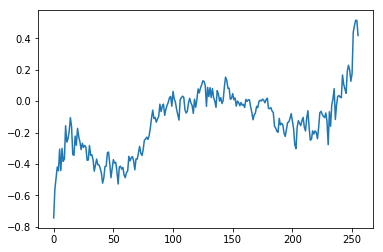

In [7]:
pyp.figure()
pyp.plot(EM[:,24])
pyp.axis('on')
pyp.show()

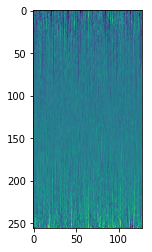

In [8]:
pyp.imshow(EM)

In [9]:
u,s,v = np.linalg.svd(EM)

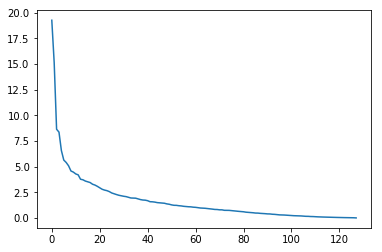

In [10]:
pyp.plot(s)

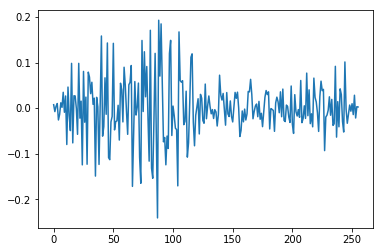

In [17]:
pyp.plot(-u[:,-3])

In [21]:
EM[:,2].shape

(256,)

Around Opus
1. (Packet Loss Concealment)
2. Compress speech using a parmeteric representation with lower bitrate
3. Something along lines of OpusNet (improve quality of something that has been compressed), possibly do something fancier



Things to try:
    1. Center around zero, (x - 128)/255 * c (reduce variance)
    2. Concatentate pcm, |pcm| and feed as input??
    3. Move prediction loop inside network
    4. Predicting Linear + Gain vs \mu law!! (Important)
        - Linear directly does not work (too noisy prediction!!!)
        - Gradient w.r.t the LPC filter (the LPC coefficients)
    (look ahead) want target to depend on prediction??
        - Network outputs excitation, try computing gradient to see if the \mu law impacts gradient computation
    Worse predictor improving loss issue (avoid)

In [ ]:
exp improved simd2, configuration time     